#### This notebook verifies the results for the Pseudo-GT obtained from Mast3r for training the Dust3r model.

### Import Required Libraries

In [1]:
import sys
sys.path.append('../mast3r')  # Add MASt3R to system path
sys.path.append('../dust3r')  # Add DUSt3R to system path

In [2]:
import os
import copy
import cv2
import numpy as np
import torch
import tempfile
import torchvision.transforms.functional
import matplotlib.pyplot as plt
from scipy.spatial import cKDTree
from PIL import Image

In [3]:
from mast3r.model import AsymmetricMASt3R
from mast3r.fast_nn import fast_reciprocal_NNs
from mast3r.cloud_opt.sparse_ga import sparse_global_alignment, estimate_focal_knowing_depth
from mast3r.cloud_opt.triangulation import batched_triangulate, matches_to_depths
from mast3r.utils.misc import hash_md5
from dust3r.inference import inference
from dust3r.utils.image import load_images
from dust3r.image_pairs import make_pairs

Warning, cannot find cuda-compiled version of RoPE2D, using a slow pytorch version instead


/home/user/javeda1/mast3r/dust3r/dust3r/cloud_opt/base_opt.py:275: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  @torch.cuda.amp.autocast(enabled=False)


### Set Device

In [4]:
device='cpu'

In [5]:
# Load MASt3R model
model_name = "../naver/MASt3R_ViTLarge_BaseDecoder_512_catmlpdpt_metric.pth"
model = AsymmetricMASt3R.from_pretrained(model_name).to(device)

... loading model from ../naver/MASt3R_ViTLarge_BaseDecoder_512_catmlpdpt_metric.pth
instantiating : AsymmetricMASt3R(enc_depth=24, dec_depth=12, enc_embed_dim=1024, dec_embed_dim=768, enc_num_heads=16, dec_num_heads=12, pos_embed='RoPE100',img_size=(512, 512), head_type='catmlp+dpt', output_mode='pts3d+desc24', depth_mode=('exp', -inf, inf), conf_mode=('exp', 1, inf), patch_embed_cls='PatchEmbedDust3R', two_confs=True, desc_conf_mode=('exp', 0, inf), landscape_only=False)
<All keys matched successfully>


### Load and Resize Images

In [6]:
# 1) Define image paths
# img1_path = '/home/user/javeda1/frame000001.jpg'
# img2_path = '/home/user/javeda1/frame000002.jpg'

img1_path = "/home/nfs/inf6/data/datasets/ThermalDBs/Freiburg/train/seq_00_day/00/fl_rgb/fl_rgb_1570722747_295433040.png"
img2_path = "/home/nfs/inf6/data/datasets/ThermalDBs/Freiburg/train/seq_00_day/00/fl_rgb/fl_rgb_1570722748_2179484080.png"


# Output paths
out1_path = "./resized_img1.png"
out2_path = "./resized_img2.png"

# Resize and save
image1 = Image.open(img1_path).convert("RGB").resize((224, 224), resample=Image.Resampling.LANCZOS)
image2 = Image.open(img2_path).convert("RGB").resize((224, 224), resample=Image.Resampling.LANCZOS)

image1.save(out1_path)
image2.save(out2_path)

filelist = [out1_path, out2_path]
# filelist = [img1_path, img2_path]

### Define parameters for Mast3r

In [7]:
# 2) General parameters
image_size = 224
shared_intrinsics = True
outdir = "./cache_output"


In [8]:
# 3) Load images
imgs = load_images(filelist, size=image_size, verbose=True,square_ok=True)
if len(imgs) == 1:
    # If there's only one image, duplicate it for alignment
    print("Only 1 image found; duplicating it for alignment.")
    imgs = [imgs[0], copy.deepcopy(imgs[0])]
    imgs[1]['idx'] = 1
    filelist = [filelist[0], filelist[0] + '_dup']

>> Loading a list of 2 images
 - adding ./resized_img1.png with resolution 224x224 --> 224x224
 - adding ./resized_img2.png with resolution 224x224 --> 224x224
 (Found 2 images)


In [9]:
# 4) Make pairs (scene_graph='complete' in this simple example)
pairs = make_pairs(imgs, scene_graph='complete', symmetrize=True)

In [10]:
# 5) Configure cache directory
cache_dir = os.path.join(outdir, 'cache')
os.makedirs(cache_dir, exist_ok=True)


### Run Inference

In [11]:
# 6) Run sparse global alignment
scene, _ = sparse_global_alignment(
    imgs=filelist,
    pairs_in=pairs,
    cache_path=cache_dir,
    model=model,          # MASt3R model
    lr1=0.2, niter1=1000, # Coarse stage
    lr2=0.02, niter2=10,  # Refinement
    device=device,        # 'cuda' or 'cpu'
    opt_depth=True,       # Optimize depth
    shared_intrinsics=shared_intrinsics,
    matching_conf_thr=5.0
)

100%|████████████████████████████████████████████████████████| 2/2 [00:00<00:00, 305.67it/s]
/home/user/javeda1/miniconda3/envs/mast3r/lib/python3.11/site-packages/torch/_compile.py:32: UserWarning: optimizer contains a parameter group with duplicate parameters; in future, this will cause an error; see github.com/pytorch/pytorch/issues/40967 for more information
  return disable_fn(*args, **kwargs)


init focal (shared) =  246.15


100%|███████████████████████████| 1000/1000 [00:04<00:00, 226.33it/s, lr=0.0000, loss=0.200]


>> final loss = 0.2004130333662033


100%|███████████████████████████████| 10/10 [00:00<00:00, 170.06it/s, lr=0.0005, loss=0.860]

>> final loss = 0.8600736856460571
Final focal (shared) =  286.83


In [12]:
pts3d, depthmaps_dense, confs = scene.get_dense_pts3d(clean_depth=True)


### Depthmaps Visualization

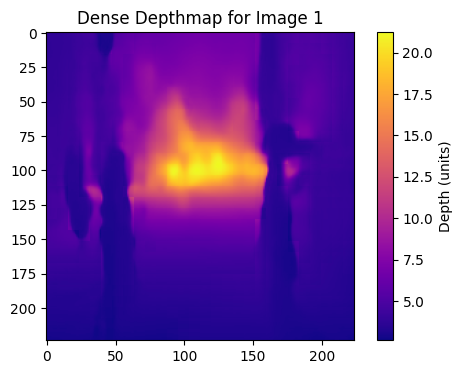

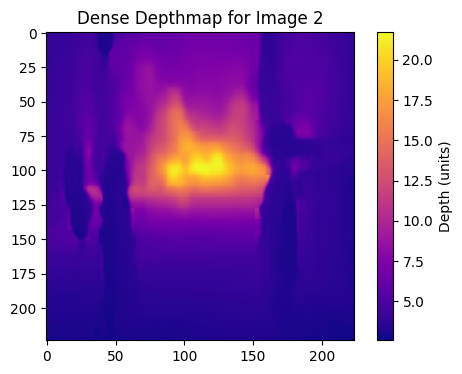

In [13]:
for i, depthmap in enumerate(depthmaps_dense):
    
    depth_1d = depthmaps_dense[i]          
    conf_2d   = confs[i]
    
    depth_2d  = depth_1d.view(*conf_2d.shape) 
    depth_np = depth_2d.detach().cpu().numpy()
    
    # depth_np[depth_np <= 0] = float('nan')
    
    plt.figure(figsize=(6, 4))
    plt.title(f"Dense Depthmap for Image {i + 1}")
    plt.imshow(depth_np, cmap='plasma')
    plt.colorbar(label='Depth (units)')
    plt.show()

### Get Pose Information

In [14]:
# per-image 4×4 poses
poses = scene.get_im_poses()

In [15]:
for i, pose in enumerate(poses):
    print(f"Pose for image {i}:\n{pose}\n")

Pose for image 0:
tensor([[ 0.7252,  0.6055, -0.3278,  1.7879],
        [-0.2017, -0.2684, -0.9420,  3.7578],
        [-0.6583,  0.7492, -0.0726,  0.7586],
        [ 0.0000,  0.0000,  0.0000,  1.0000]])

Pose for image 1:
tensor([[ 0.7286,  0.6144, -0.3027,  1.6931],
        [-0.1844, -0.2496, -0.9506,  3.8456],
        [-0.6596,  0.7484, -0.0685,  0.7657],
        [ 0.0000,  0.0000,  0.0000,  1.0000]])



In [16]:
import roma  # a rotation/geometry library used in MASt3R

for i, pose in enumerate(poses):
    R = pose[:3, :3]  # rotation
    t = pose[:3, 3]   # translation
    quat = roma.rotmat_to_unitquat(R)
    print(f"Image {i} rotation:\n{R}\n translation:\n{t}\n quaternion: {quat}")

Image 0 rotation:
tensor([[ 0.7252,  0.6055, -0.3278],
        [-0.2017, -0.2684, -0.9420],
        [-0.6583,  0.7492, -0.0726]])
 translation:
tensor([1.7879, 3.7578, 0.7586])
 quaternion: tensor([ 0.7187,  0.1405, -0.3430,  0.5883])
Image 1 rotation:
tensor([[ 0.7286,  0.6144, -0.3027],
        [-0.1844, -0.2496, -0.9506],
        [-0.6596,  0.7484, -0.0685]])
 translation:
tensor([1.6931, 3.8456, 0.7657])
 quaternion: tensor([ 0.7153,  0.1503, -0.3363,  0.5938])


### Check Validity of Rotation and Translation Matrices

In [17]:
def check_rotation_matrix(R, tol=1e-5):
    # R is a 3×3 matrix
    # Check orthonormality
    should_be_identity = R.t().mm(R)
    identity_diff = (should_be_identity - torch.eye(3, device=R.device)).abs().max()
    # Check determinant
    det = torch.det(R)
    print(f"Max deviation from I: {identity_diff}, Determinant: {det}")
    if identity_diff < tol and abs(det - 1.0) < tol:
        print("R looks like a valid rotation matrix.")
    else:
        print("WARNING: R fails orthonormality/determinant checks.")

check_rotation_matrix(R)

Max deviation from I: 1.1920928955078125e-07, Determinant: 0.9999999403953552
R looks like a valid rotation matrix.


In [18]:
def check_translation(t, expected_range=(0, 10)):
    length = t.norm().item()
    print(f"Translation length: {length}")
    if not (expected_range[0] <= length <= expected_range[1]):
        print("Translation magnitude is unexpected for this scene.")
check_translation(t)

Translation length: 4.271049499511719


### Get Camera Intrinsics

In [19]:
def make_intrinsics(focal, pp, device):
    # Handle scalar focal case (fx = fy)
    if focal.ndim == 0:
        fx = fy = focal.item()
    else:
        fx, fy = focal.tolist()

    cx, cy = pp.tolist()
    K = torch.tensor([
        [fx, 0,  cx],
        [0,  fy, cy],
        [0,  0,   1]
    ], device=device, dtype=torch.float32)
    return K

In [20]:
# Intrinsic matrices
def make_intrinsics_np(focal, pp):
    if focal.ndim == 0:
        fx = fy = float(focal)
    else:
        fx, fy = focal
    cx, cy = pp
    K = np.array([
        [fx, 0,  cx],
        [0,  fy, cy],
        [0,  0,   1]
    ], dtype=np.float32)
    return K

In [21]:
images = load_images([img1_path, img2_path], size=image_size)
output = inference([tuple(images)], model, device, batch_size=1, verbose=False)

view1, pred1 = output['view1'], output['pred1']
view2, pred2 = output['view2'], output['pred2']

desc1, desc2 = pred1['desc'].squeeze(0).detach(), pred2['desc'].squeeze(0).detach()

# find 2D-2D matches between the two images
matches_im0, matches_im1 = fast_reciprocal_NNs(desc1, desc2, subsample_or_initxy1=8,
                                                   device=device, dist='dot', block_size=2**13)

>> Loading a list of 2 images
 - adding /home/nfs/inf6/data/datasets/ThermalDBs/Freiburg/train/seq_00_day/00/fl_rgb/fl_rgb_1570722747_295433040.png with resolution 1920x650 --> 224x224
 - adding /home/nfs/inf6/data/datasets/ThermalDBs/Freiburg/train/seq_00_day/00/fl_rgb/fl_rgb_1570722748_2179484080.png with resolution 1920x650 --> 224x224
 (Found 2 images)


/home/user/javeda1/mast3r/dust3r/dust3r/inference.py:44: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with torch.cuda.amp.autocast(enabled=bool(use_amp)):
/home/user/javeda1/mast3r/dust3r/dust3r/model.py:205: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with torch.cuda.amp.autocast(enabled=False):
/home/user/javeda1/mast3r/dust3r/dust3r/inference.py:48: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with torch.cuda.amp.autocast(enabled=False):


In [22]:
# Get poses and intrinsics
focal0, focal1 = scene.get_focals()[:2]
pp0, pp1 = scene.get_principal_points()[:2]

focal0 = focal0.detach().cpu().numpy()
focal1 = focal1.detach().cpu().numpy()

pp0 = pp0.detach().cpu().numpy()
pp1 = pp1.detach().cpu().numpy()

### 3D Reprojection Error Computation between Two Views

This code calculates the reprojection error by transforming 2D keypoints from image 1 into 3D world coordinates using depth and camera intrinsics, then reprojecting them into image 2 using its camera pose and intrinsics

In [23]:
# Step 1: Get intrinsics and poses
K1 = make_intrinsics_np(focal0, pp0)  # image 1
K2 = make_intrinsics_np(focal1, pp1)  # image 2
pose1 = scene.get_im_poses()[0].cpu().numpy()  # cam1-to-world
pose2 = scene.get_im_poses()[1].cpu().numpy()  # cam2-to-world

# Step 2: Invert pose2 to get world-to-cam2
w2c2 = np.linalg.inv(pose2)

# Step 3: Get 2D keypoints and depth values from image 1
u1 = matches_im0[:, 0].astype(np.int32)
v1 = matches_im0[:, 1].astype(np.int32)
depth1_np = depthmaps_dense[0].cpu().numpy().reshape(*conf_2d.shape)
z = depth1_np[v1, u1] 

# Step 4: Unproject pixels from image 1 to 3D in camera 1
pix1 = np.stack([u1, v1, np.ones_like(u1)], axis=0)  # [3, N]
K1_inv = np.linalg.inv(K1)
xyz_cam1 = (K1_inv @ pix1) * z

# Step 5: Convert to world coordinates
xyz_cam1_h = np.concatenate([xyz_cam1, np.ones((1, xyz_cam1.shape[1]))], axis=0)
xyz_world = (pose1 @ xyz_cam1_h)[:3].T

# Step 6: Transform to image 2 camera coordinates
xyz_world_h = np.concatenate([xyz_world, np.ones((len(xyz_world), 1))], axis=1).T
xyz_cam2 = (w2c2 @ xyz_world_h)[:3].T

# Step 7: Project into image 2
xyz_cam2 += 1e-8  # division by zero
xy = xyz_cam2[:, :2] / xyz_cam2[:, 2:3] 
uv_proj = (K2[:2, :2] @ xy.T).T + K2[:2, 2]

# Step 8: Compare with actual matched keypoints from image 2
uv_gt = matches_im1.astype(np.float32)
reproj_error = np.linalg.norm(uv_proj - uv_gt, axis=1)
mean_error = np.mean(reproj_error)

print(f"Mean reprojection error (via full 3D transform): {mean_error:.2f} pixels")


Mean reprojection error (via full 3D transform): 16.63 pixels


#### Warping an Image to another Image Viewpoint Using Depth and Camera Poses

This function shows a warped version of the original image, showing how it would look from the second camera's perspective.

In [24]:
import torch.nn.functional as F

def warp_image_to_other_view(image1, depth1, pose1, pose2, K1, K2):
    """
    Warps image1 to image2’s viewpoint using depth and camera transforms.
    """
    device = image1.device
    B, _, H, W = 1, *image1.shape

    # Make meshgrid
    y, x = torch.meshgrid(
        torch.arange(H, device=device),
        torch.arange(W, device=device),
        indexing='ij'
    )
    ones = torch.ones_like(x).float()
    pix = torch.stack((x, y, ones), dim=0).reshape(3, -1)

    # Backproject to 3D in cam1
    K1_inv = torch.inverse(K1)
    z = depth1.reshape(-1)
    xyz_cam1 = (K1_inv @ pix) * z 
    xyz_cam1_h = torch.cat([xyz_cam1, ones.reshape(1, -1)], dim=0)

    # Transform to cam2
    w2c2 = torch.inverse(pose2)
    xyz_cam2 = (w2c2 @ (pose1 @ xyz_cam1_h))[:3]

    # Project into cam2
    xyz_cam2 += 1e-8
    xy = xyz_cam2[:2] / xyz_cam2[2:]
    uv = (K2[:2, :2] @ xy) + K2[:2, 2:3]

    # Normalize
    u = uv[0] / (W - 1) * 2 - 1
    v = uv[1] / (H - 1) * 2 - 1
    grid = torch.stack((u, v), dim=-1).reshape(1, H, W, 2)

    image1 = image1.unsqueeze(0)
    warped = F.grid_sample(image1, grid, mode='bilinear', padding_mode='zeros', align_corners=True)
    return warped.squeeze(0)


In [25]:
image1 = imgs[0]['img'].to(device).squeeze(0)
image2 = imgs[1]['img'].to(device).squeeze(0)

depth1 = depthmaps_dense[0].to(device)
pose1 = scene.get_im_poses()[0].to(device)
pose2 = scene.get_im_poses()[1].to(device)
K1 = make_intrinsics(focal0, pp0, device)
K2 = make_intrinsics(focal1, pp1, device)

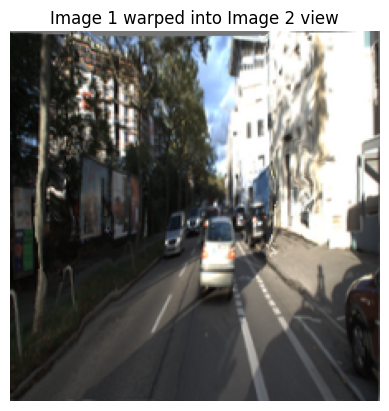

In [26]:
# Warp
warped_img1_to_2 = warp_image_to_other_view(image1, depth1, pose1, pose2, K1, K2)

# Visualize
def show_img(tensor_img, title="Image"):
    npimg = tensor_img.permute(1,2,0).detach().cpu().numpy()
    npimg = (npimg - npimg.min())/(npimg.max() - npimg.min())
    plt.imshow(np.clip(npimg, 0, 1))
    plt.title(title)
    plt.axis("off")
    plt.show()

show_img(warped_img1_to_2, "Image 1 warped into Image 2 view")


In [27]:
F.l1_loss(warped_img1_to_2, image2)

tensor(0.3222)

### Visualizing 3D Point Clouds from Image and Depth

In [28]:
import open3d as o3d

def wrap_3d_points_to_view(image, depth, K, pose, colorize=True):
    """
    Converts image + depth into a 3D point cloud in world coordinates.
    """
    C, H, W = image.shape
    device = image.device

    # 1. Create pixel grid
    y, x = torch.meshgrid(
        torch.arange(H, device=device),
        torch.arange(W, device=device),
        indexing='ij'
    )
    ones = torch.ones_like(x)
    pix = torch.stack([x, y, ones], dim=0).reshape(3, -1).float()  # [3, N]

    # 2. Backproject to 3D
    K_inv = torch.inverse(K)
    z = depth.reshape(-1)
    xyz_cam = (K_inv @ pix) * z  # [3, N]
    xyz_cam = xyz_cam.T  # [N, 3]

    # 3. Transform to world coordinates
    xyz_cam_h = torch.cat([xyz_cam, torch.ones((xyz_cam.shape[0], 1), device=device)], dim=1)  # [N, 4]
    xyz_world = (pose @ xyz_cam_h.T).T[:, :3]  # [N, 3]

    # 4. Colorize
    if colorize:
        rgb = image.permute(1, 2, 0).reshape(-1, 3).detach().cpu().numpy()
    else:
        rgb = None

    return xyz_world.detach().cpu().numpy(), rgb


Jupyter environment detected. Enabling Open3D WebVisualizer.
[Open3D INFO] WebRTC GUI backend enabled.
[Open3D INFO] WebRTCWindowSystem: HTTP handshake server disabled.


In [29]:
def wrap_3d_points_to_view(image, depth, K, pose, colorize=True):
    """
    Converts image + depth into a 3D point cloud in world coordinates.
    Applies min-max normalization to colors to improve visualization.
    """
    C, H, W = image.shape
    device = image.device

    # 1. Create pixel grid
    y, x = torch.meshgrid(
        torch.arange(H, device=device),
        torch.arange(W, device=device),
        indexing='ij'
    )
    ones = torch.ones_like(x)
    pix = torch.stack([x, y, ones], dim=0).reshape(3, -1).float()

    # 2. Backproject to 3D
    K_inv = torch.inverse(K)
    z = depth.reshape(-1)
    xyz_cam = (K_inv @ pix) * z  # [3, N]
    xyz_cam = xyz_cam.T  # [N, 3]

    # 3. Transform to world coordinates
    xyz_cam_h = torch.cat([xyz_cam, torch.ones((xyz_cam.shape[0], 1), device=device)], dim=1)  # [N, 4]
    xyz_world = (pose @ xyz_cam_h.T).T[:, :3]

    # 4. Colorize
    if colorize:
        rgb = image.permute(1, 2, 0).reshape(-1, 3)
        rgb_min = rgb.min(dim=0, keepdim=True)[0]
        rgb_max = rgb.max(dim=0, keepdim=True)[0]
        rgb_range = rgb_max - rgb_min
        rgb = (rgb - rgb_min) / (rgb_range + 1e-6) 
        rgb = rgb.clamp(0, 1).detach().cpu().numpy()
    else:
        rgb = None

    return xyz_world.detach().cpu().numpy(), rgb


In [30]:
pts3d_world, rgb = wrap_3d_points_to_view(image1, depth1, K1, pose1)

# Visualize with Open3D
pcd = o3d.geometry.PointCloud()
pcd.points = o3d.utility.Vector3dVector(pts3d_world)
if rgb is not None:
    pcd.colors = o3d.utility.Vector3dVector(rgb)

o3d.visualization.draw_plotly([pcd])

#### Creating a 3D Camera Frustum for Visualization

In [31]:
def create_camera_frustum(K, pose, image_size, scale=0.3, color=[1, 0, 0]):
    """
    Create a 3D frustum from camera intrinsics and pose.
    """
    fx, fy = K[0, 0], K[1, 1]
    cx, cy = K[0, 2], K[1, 2]
    H, W = image_size

    # Define 4 corner rays in pixel coordinates
    corners = np.array([
        [0,     0,    1],
        [W-1,   0,    1],
        [W-1, H-1,    1],
        [0,   H-1,    1]
    ]).T 

    K_inv = np.linalg.inv(K)
    rays = K_inv @ corners * scale

    # Frustum lines: from origin to corners
    points = np.concatenate([np.zeros((1, 3)), rays.T], axis=0)
    lines = [[0, i] for i in range(1, 5)] + [[1,2], [2,3], [3,4], [4,1]]
    colors = [color for _ in lines]

    points_h = np.concatenate([points, np.ones((5, 1))], axis=1)
    points_world = (pose @ points_h.T).T[:, :3]

    frustum = o3d.geometry.LineSet()
    frustum.points = o3d.utility.Vector3dVector(points_world)
    frustum.lines = o3d.utility.Vector2iVector(lines)
    frustum.colors = o3d.utility.Vector3dVector(colors)
    return frustum


In [32]:
H, W = conf_2d.shape
image_size = (H, W)

K1_np = K1.cpu().numpy()
K2_np = K2.cpu().numpy()
pose0_np = pose1.cpu().numpy()
pose1_np = pose2.cpu().numpy()

# Frustum for each camera
frustum0 = create_camera_frustum(K1_np, pose0_np, image_size, scale=0.3, color=[1,0,0])  # red
frustum1 = create_camera_frustum(K2_np, pose1_np, image_size, scale=0.3, color=[0,1,0])  # green


pcd = o3d.geometry.PointCloud()
pcd.points = o3d.utility.Vector3dVector(pts3d_world)
pcd.colors = o3d.utility.Vector3dVector(rgb)

o3d.visualization.draw_plotly([pcd, frustum0, frustum1])


In [33]:
import imageio

### Rendering a Rotating 3D Scene to a GIF

In [34]:
def render_scene_gif_offscreen(objects, gif_path='camera_scene.gif', n_frames=60, width=1024, height=768):
    """
    Render rotating scene GIF using Open3D's offscreen renderer (headless-safe).
    """
    # Setup renderer
    renderer = o3d.visualization.rendering.OffscreenRenderer(width, height)
    scene = renderer.scene
    scene.set_background([1, 1, 1, 1])  # white background
    scene.scene.set_sun_light(
    direction=np.array([0.0, -1.0, -1.0], dtype=np.float32),
    color=np.array([1.0, 1.0, 1.0], dtype=np.float32),
    intensity=1.0
    )
    scene.scene.enable_sun_light(True)

    # Add geometries
    for i, obj in enumerate(objects):
        mat = o3d.visualization.rendering.MaterialRecord()
        mat.shader = "defaultUnlit"
        scene.add_geometry(f"obj_{i}", obj, mat)

    # Center camera
    bounds = scene.bounding_box
    center = bounds.get_center()
    radius = np.linalg.norm(bounds.get_extent()) * 1.5
    up = [0, 1, 0]
    eye = center + [0, 0, radius]
    scene.camera.look_at(center, eye, up)

    images = []
    for i in range(n_frames):
        theta = 2 * np.pi * i / n_frames
        cam_eye = center + radius * np.array([np.sin(theta), 0, np.cos(theta)])
        scene.camera.look_at(center, cam_eye, up)

        img = renderer.render_to_image()
        img_np = np.asarray(img)
        images.append(img_np)

    # Save GIF
    imageio.mimsave(gif_path, images, fps=15)
    print(f"GIF saved: {gif_path}")

In [35]:
render_scene_gif_offscreen(
    objects=[pcd, frustum0, frustum1],
    gif_path='car_camera_scene.gif',
    n_frames=100
)

[Open3D INFO] EGL headless mode enabled.
GIF saved: car_camera_scene.gif


#### Checking Relative Pose Between Two Camera Transforms

In [36]:
from scipy.spatial.transform import Rotation as R

def check_relative_pose(pose1, pose2):
    """
    Returns:
    - relative rotation (degrees)
    - translation vector and magnitude
    """
    # World-to-camera
    w2c1 = np.linalg.inv(pose1)
    w2c2 = np.linalg.inv(pose2)

    # Relative transform from cam1 to cam2
    T_1to2 = w2c2 @ pose1 

    # Extract relative rotation and translation
    R_rel = T_1to2[:3, :3]
    t_rel = T_1to2[:3, 3]

    # Convert rotation matrix to angle (in degrees)
    rotvec = R.from_matrix(R_rel).as_rotvec()
    angle_deg = np.linalg.norm(rotvec) * 180 / np.pi

    print(f"Relative Rotation Angle: {angle_deg:.2f} degrees")
    print(f"Relative Translation: {t_rel}")
    print(f"Translation Magnitude: {np.linalg.norm(t_rel):.3f}")


In [37]:
check_relative_pose(pose0_np, pose1_np)

Relative Rotation Angle: 1.56 degrees
Relative Translation: [0.08990079 0.07481879 0.05532885]
Translation Magnitude: 0.129
